In [2]:
# There are 3 python packages that i typically use to handle image data...
from PIL import Image
import skimage
import cv2

In [3]:
# Let's start by celebrating a very cool person in computer science history! 
Hopper_URL = "https://upload.wikimedia.org/wikipedia/commons/a/ad/Commodore_Grace_M._Hopper%2C_USN_%28covered%29.jpg"

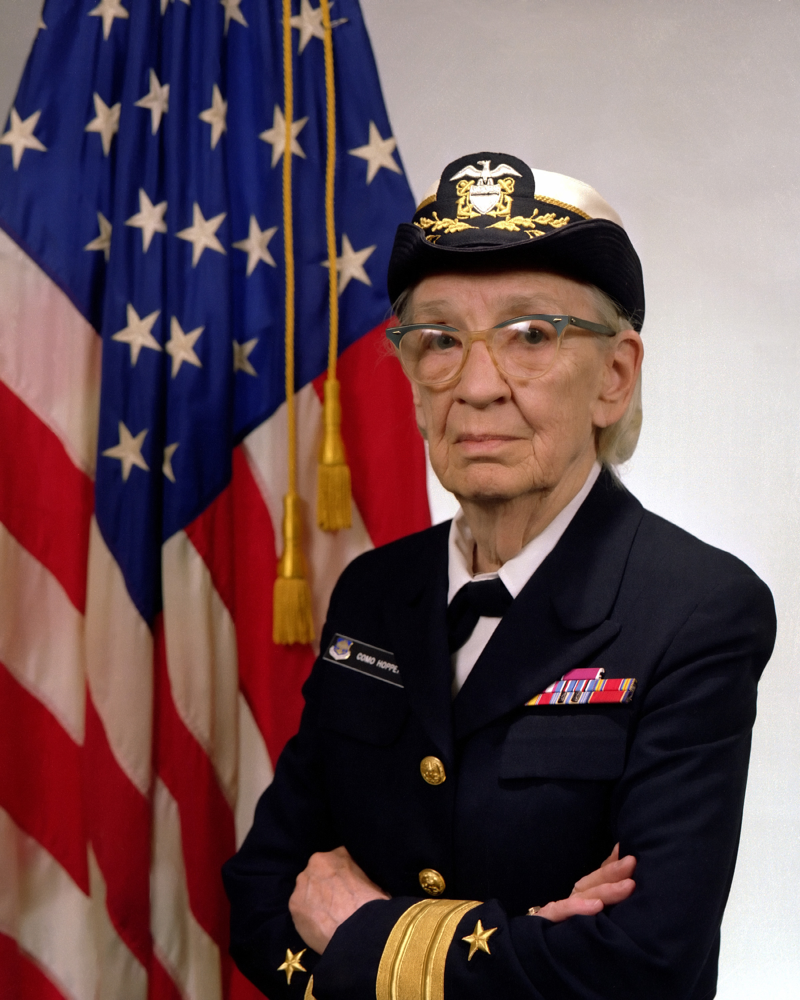

In [4]:
from urllib.request import urlopen

img = Image.open(urlopen(Hopper_URL))
img

In [ ]:
# This image is pretty big! How do we resize it?
# Because we are using PIL, this is very easy! The image is loaded as an object and not just an array of values, so we can perform actions on it! 

# Note: skimage and many other 
#TODO: does cv2 do this?

In [7]:
img.size

(2400, 3000)

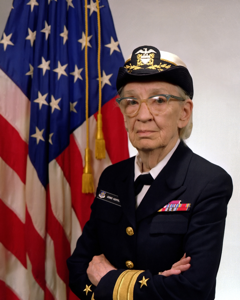

In [8]:
img.resize((240,300))

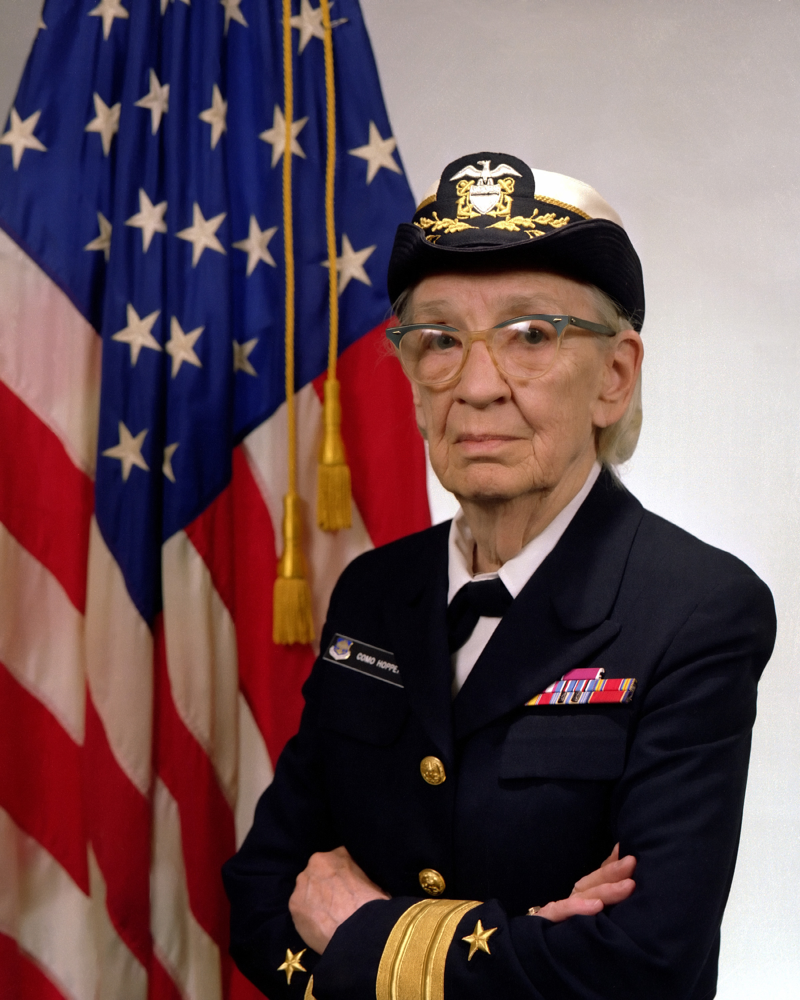

In [12]:
# this change is not permanent! 
img # this is enough to display the image below! 

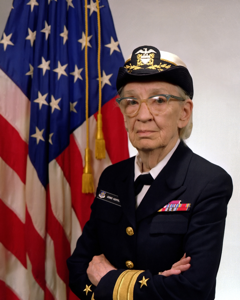

In [36]:
# to make this permanent, we have to create a new image object
img_small = img.resize((240,300))
img_small

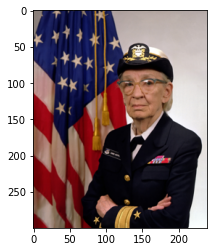

In [51]:
import matplotlib.pyplot as plt

# Create figure and axes
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(img_small)

plt.show()

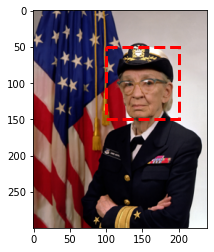

In [52]:
import matplotlib.patches as patches

# Create figure and axes
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(img_small)

# Create a Rectangle patch
rect = patches.Rectangle((100,50),100,100,linewidth=3,edgecolor='r',facecolor='none',linestyle="--")

# Add the patch to the Axes
ax.add_patch(rect)

plt.show()

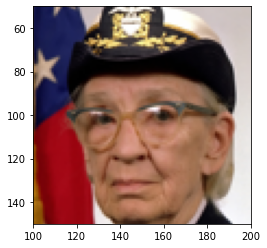

In [58]:
# of course to crop the image, we could just set the x and y limits using matplotlib.

# Create figure and axes
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(img_small)

ax.set_xlim(100,200)
ax.set_ylim(150,50)

plt.show()

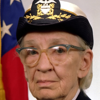

In [59]:
# but this just puts the image into a plot and then crops that if you then save it.... and remove the tick labels and line! 

# We can instead use an internal function of PIL
img_small_crop = img_small.crop((100,50,200,150))
img_small_crop

In [119]:
img_20x20 = img_small_crop.resize((20,20))
img_20x20

In [120]:
# rotate
# flip
# other transformations

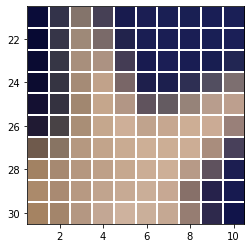

In [121]:
# now, images are just 2D arrays!

# Create figure and axes
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(img_small_crop)

for x in np.linspace(0,9,10):
    ax.axvline(x=x+0.5, color='w', linestyle='-',linewidth=2)

for y in np.linspace(20,29,10):
    ax.axhline(y=y+0.5, color='w', linestyle='-',linewidth=2)

ax.set_xlim(0+0.5,10+0.5)
ax.set_ylim(30+0.5,20+0.5)

plt.show()

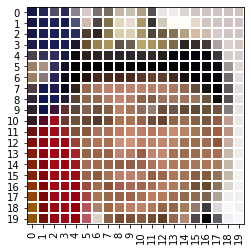

In [129]:
# now, images are just 2D arrays!

# Create figure and axes
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(img_20x20)

pixel_len = np.linspace(0,19,20,dtype="int")

for pixel in pixel_len:
    ax.axvline(x=pixel+0.5, color='w', linestyle='-',linewidth=2)
    ax.axhline(y=pixel+0.5, color='w', linestyle='-',linewidth=2)

ax.set_xticks(pixel_len)
ax.set_xticklabels(pixel_len, rotation = 90)
ax.set_yticks(pixel_len)
ax.set_yticklabels(pixel_len, rotation = 0)

plt.show()

In [133]:
"""
Demonstrates using custom hillshading in a 3D surface plot.
"""
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cbook
from matplotlib import cm
from matplotlib.colors import LightSource
import matplotlib.pyplot as plt
import numpy as np

filename = cbook.get_sample_data('jacksboro_fault_dem.npz', asfileobj=False)
with np.load(filename) as dem:
    z = dem['elevation']
    nrows, ncols = z.shape
    x = np.linspace(dem['xmin'], dem['xmax'], ncols)
    y = np.linspace(dem['ymin'], dem['ymax'], nrows)
    x, y = np.meshgrid(x, y)

region = np.s_[5:50, 5:50]
x, y, z = x[region], y[region], z[region]

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))

ls = LightSource(270, 45)
# To use a custom hillshading mode, override the built-in shading and pass
# in the rgb colors of the shaded surface calculated from "shade".
rgb = ls.shade(z, cmap=cm.gist_earth, vert_exag=0.1, blend_mode='soft')
surf = ax.plot_surface(x, y, z, rstride=1, cstride=1, facecolors=rgb,
                       linewidth=0, antialiased=False, shade=False)

plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\ProgramData\\Anaconda3\\envs\\mpl\\lib\\site-packages\\matplotlib\\mpl-data\\sample_data\\jacksboro_fault_dem.npz'

In [89]:
# we can officially change it to a 2D numpy array! 
img_small_crop_arr = np.asarray(img_small_crop)

In [91]:
# what is the shape of this array?
img_small_crop_arr.shape

(100, 100, 3)

In [ ]:
# 100 pixels x 100 pixels with 3 color channels!

In [96]:
print(img_small_crop.size)
print(img_small_crop.mode)

(100, 100)
RGB


C:\ProgramData\Anaconda3\envs\mpl\lib\site-packages\skimage\feature\blob.py:125: RuntimeWarning: invalid value encountered in double_scalars
  r1 = blob1[-1] / blob2[-1]
C:\ProgramData\Anaconda3\envs\mpl\lib\site-packages\skimage\feature\blob.py:126: RuntimeWarning: divide by zero encountered in true_divide
  pos1 = blob1[:ndim] / (max_sigma * root_ndim)
C:\ProgramData\Anaconda3\envs\mpl\lib\site-packages\skimage\feature\blob.py:127: RuntimeWarning: divide by zero encountered in true_divide
  pos2 = blob2[:ndim] / (max_sigma * root_ndim)
C:\ProgramData\Anaconda3\envs\mpl\lib\site-packages\skimage\feature\blob.py:129: RuntimeWarning: invalid value encountered in subtract
  d = np.sqrt(np.sum((pos2 - pos1)**2))


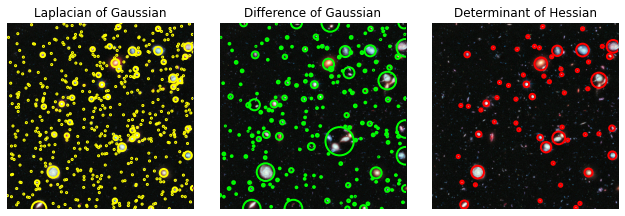

In [1]:
# https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_blob.html#sphx-glr-auto-examples-features-detection-plot-blob-py
from math import sqrt
from skimage import data
from skimage.feature import blob_dog, blob_log, blob_doh
from skimage.color import rgb2gray

import matplotlib.pyplot as plt


image = data.hubble_deep_field()[0:500, 0:500]
image_gray = rgb2gray(image)

blobs_log = blob_log(image_gray, max_sigma=30, num_sigma=10, threshold=.1)

# Compute radii in the 3rd column.
blobs_log[:, 2] = blobs_log[:, 2] * sqrt(2)

blobs_dog = blob_dog(image_gray, max_sigma=30, threshold=.1)
blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

blobs_doh = blob_doh(image_gray, max_sigma=30, threshold=.01)

blobs_list = [blobs_log, blobs_dog, blobs_doh]
colors = ['yellow', 'lime', 'red']
titles = ['Laplacian of Gaussian', 'Difference of Gaussian',
          'Determinant of Hessian']
sequence = zip(blobs_list, colors, titles)

fig, axes = plt.subplots(1, 3, figsize=(9, 3), sharex=True, sharey=True)
ax = axes.ravel()

for idx, (blobs, color, title) in enumerate(sequence):
    ax[idx].set_title(title)
    ax[idx].imshow(image)
    for blob in blobs:
        y, x, r = blob
        c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
        ax[idx].add_patch(c)
    ax[idx].set_axis_off()

plt.tight_layout()
plt.show()